# Time Lags

All of our maps are prepped so we just need to:

1. Load the maps from each channel
2. Stack them into a single array
3. Interpolate them to a common time
4. Compute time lags between interpolated datacubes
5. Build a map of each time lag using the celestial WCS
6. Save the datacube

Steps 3 and 4 can probably be done with `xarray`

In [1]:
import sys
import pathlib
from itertools import combinations

import astropy.time
import astropy.table
import astropy.units as u
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np
import sunpy.map
import xarray

from astropy.visualization import ImageNormalize, AsinhStretch, AsymmetricPercentileInterval
from sunkit_image.time_lag import time_lag, max_cross_correlation

sys.path.append('../scripts/')
import colormaps

In [2]:
ar_table = astropy.table.QTable.read('../data/tables/mason_ars_region_1.asdf')

In [3]:
ar_table

NOAA AR,Comment,Date start,Date end,Date mid,bottom left,top right,EIS file
,,,,,arcsec,arcsec,
int64,str80,Time,Time,Time,float64[2],float64[2],str19
11944,Adjusted start time to avoid flare on 2014-01-07 18:00:00,2014-01-08T06:00:00.000,2014-01-08T18:00:00.000,2014-01-08T12:00:00.000,-200.0 .. -330.0,330.0 .. 100.0,eis_20140108_095727
11967,Adjusted start time to center interval on EIS raster scan,2014-02-03T05:00:00.000,2014-02-03T17:00:00.000,2014-02-03T11:00:00.000,-278.0 .. -300.0,260.0 .. 100.0,eis_20140203_093134
11990,Adjusted start time to avoid eclipse on 2014-03-02 06:00:00,2014-03-01T18:00:00.000,2014-03-02T06:00:00.000,2014-03-02T00:00:00.000,-350.0 .. -350.0,150.0 .. 0.0,eis_20140302_000659


In [4]:
time_common = np.arange(0, 12, (1*u.minute).to_value('h')) * u.h
channel_list = ['94', '131', '171', '193', '211', '335']
root_dir = pathlib.Path('../data/')

In [5]:
for row in ar_table:
    print(row['NOAA AR'])
    top_dir = root_dir / f'noaa_{row["NOAA AR"]}' / 'AIA'
    for l2_dir in ['level_2', 'level_2_EIS']:
        print(l2_dir)
        parts = l2_dir.split('_')
        lev_label = f'{parts[0][:-2]}{parts[1]}'
        if len(parts)>2:
            lev_label = f'{lev_label}{parts[2].lower()}'
        ds = {}
        for channel in channel_list:
            print(channel)
            file_list = sorted((top_dir / l2_dir).glob(f'aia.{lev_label}_euv_12s.*.{channel}.image.fits'))
            maps = sunpy.map.Map(file_list)
            times = astropy.time.Time([m.meta['t_obs'] for m in maps if m.meta['quality']==0]) 
            times = (times - row['Date start']).to('s')
            data_array = np.array([m.data for m in maps if m.meta['quality']==0])
            time_coord = xarray.DataArray(times.value,
                                          dims=['time'],
                                          attrs={'unit': times.unit.to_string()})
            da = xarray.DataArray(data_array,
                                  dims=['time', 'pixel_y', 'pixel_x'],
                                  coords={'time': time_coord},
                                  attrs={'unit': maps[0].unit.to_string(),
                                         **dict(maps[0].wcs.to_header())})
            # Fill NaN values
            da = da.ffill('time')
            # Replace negative values with 0s (should have done this in the L1->L2 step)
            da = da.where(da>0, 0.0)
            # Interpolate datacube
            da = da.interp(time=time_common.to_value(times.unit), kwargs={'fill_value': 'extrapolate'})
            # Build dataset
            ds[channel] = da
        ds = xarray.Dataset(ds,).chunk({'pixel_x': 'auto', 'pixel_y': 'auto'})
        ds.to_zarr(top_dir / f'{l2_dir}_datacubes.zarr')

11990
level_2
94
131
171
193
211
335
level_2_EIS
94
131
171
193
211
335


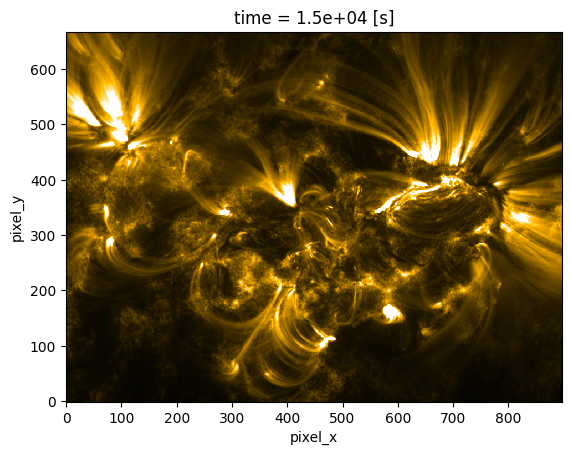

In [30]:
ds_from_file['171'][250,...].plot.imshow(cmap='sdoaia171',
                                         vmin=0,
                                         vmax=2000,
                                         add_colorbar=False)

## Time Lag Computation

In [5]:
channel_combinations = list(combinations(channel_list,2))
channel_combinations = channel_combinations[:5] + [sorted(c, key=lambda x: float(x), reverse=True) for c in channel_combinations[5:]]

In [6]:
import dask.distributed
client = dask.distributed.Client()

In [7]:
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 5
Total threads: 10,Total memory: 64.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:51982,Workers: 5
Dashboard: http://127.0.0.1:8787/status,Total threads: 10
Started: Just now,Total memory: 64.00 GiB
Comm: tcp://127.0.0.1:52006,Total threads: 2
Dashboard: http://127.0.0.1:52011/status,Memory: 12.80 GiB
Nanny: tcp://127.0.0.1:51985,


In [8]:
for row in ar_table:
    print(row['NOAA AR'])
    top_dir = root_dir / f'noaa_{row["NOAA AR"]}'
    for l2_dir in ['level_2', 'level_2_EIS']:
        print(l2_dir)
        ds = xarray.open_dataset(top_dir / 'AIA' / f'{l2_dir}_datacubes.zarr/',
                                 engine='zarr',
                                 chunks={})
        time_quantity = u.Quantity(ds.time.data, ds.time.attrs['unit']).to('s')
        tl_dir = top_dir / 'diagnostics' / 'max_cc'
        fov_label = f'fov{"EIS" if l2_dir=='level_2_EIS' else "AIA"}'
        tl_dir.mkdir(exist_ok=True, parents=True)
        for channel_a, channel_b in channel_combinations:
            print(channel_a,channel_b)
            tl = max_cross_correlation(ds[channel_a].data,
                                       ds[channel_b].data,
                                       time_quantity,
                                       lag_bounds=[-6,6]*u.h)
            tl = tl.compute()
            _meta = ds[channel_a].attrs.copy()
            _meta.pop('unit')
            #_meta['BUNIT'] = time_quantity.unit.to_string()
            _meta['CHAN_A'] = channel_a
            _meta['CHAN_B'] = channel_b
            tl_map = sunpy.map.Map(tl, _meta)
            tl_map.save(tl_dir / f'maxcc_noaa{row["NOAA AR"]}_{fov_label}_{channel_a}-{channel_b}.fits')

11944
level_2
94 131
94 171
94 193
94 211
94 335
171 131
193 131
211 131
335 131
193 171
211 171
335 171
211 193
335 193
335 211
level_2_EIS
94 131
94 171
94 193
94 211
94 335
171 131
193 131
211 131
335 131
193 171
211 171
335 171
211 193
335 193
335 211
11967
level_2
94 131
94 171
94 193
94 211
94 335
171 131
193 131
211 131
335 131
193 171
211 171
335 171
211 193
335 193
335 211
level_2_EIS
94 131
94 171
94 193
94 211
94 335
171 131
193 131
211 131
335 131
193 171
211 171
335 171
211 193
335 193
335 211
11990
level_2
94 131
94 171
94 193
94 211
94 335
171 131
193 131
211 131
335 131
193 171
211 171
335 171
211 193
335 193
335 211
level_2_EIS
94 131
94 171
94 193
94 211
94 335
171 131
193 131
211 131
335 131
193 171
211 171
335 171
211 193
335 193
335 211


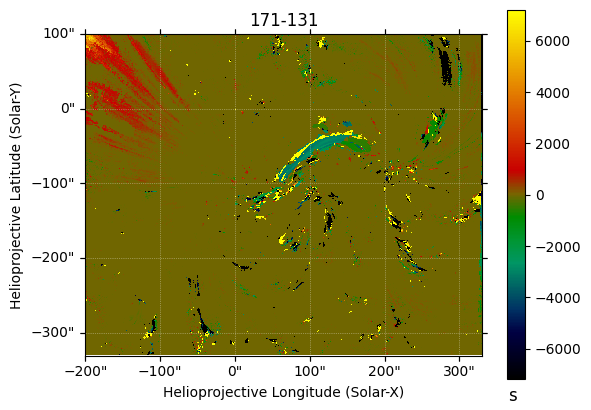

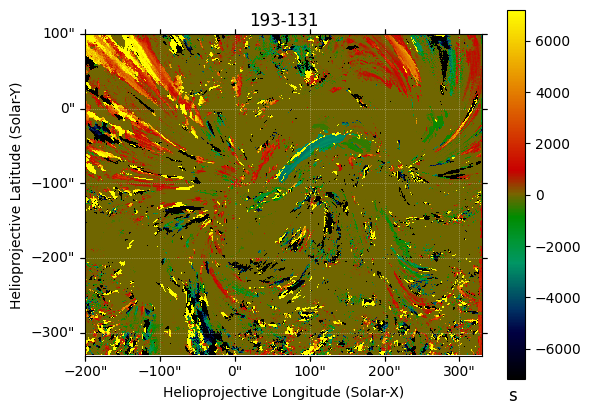

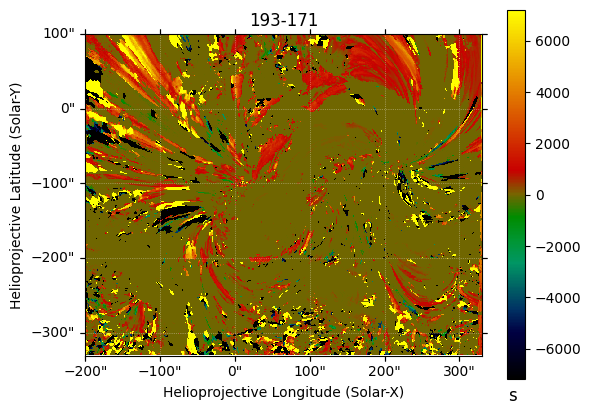

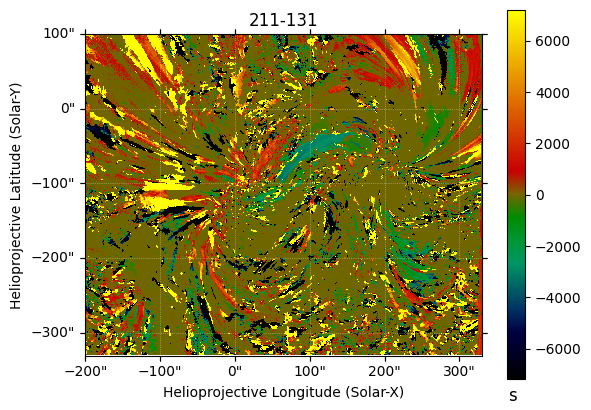

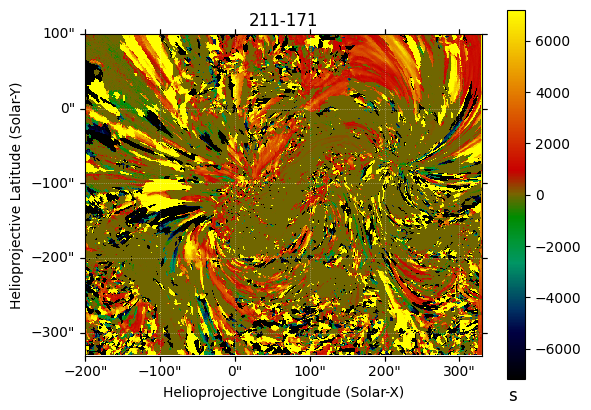

...

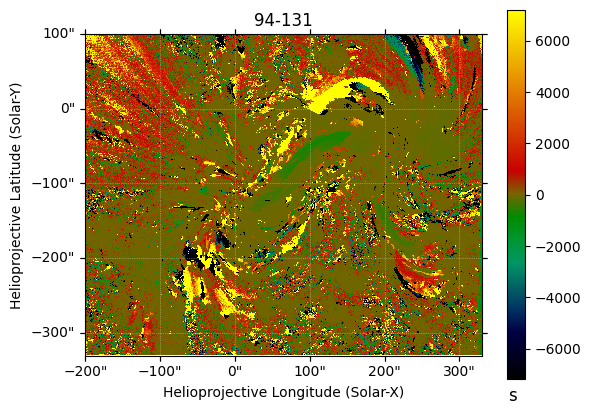

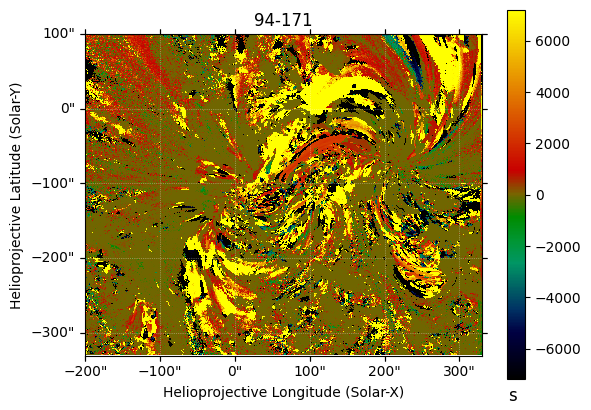

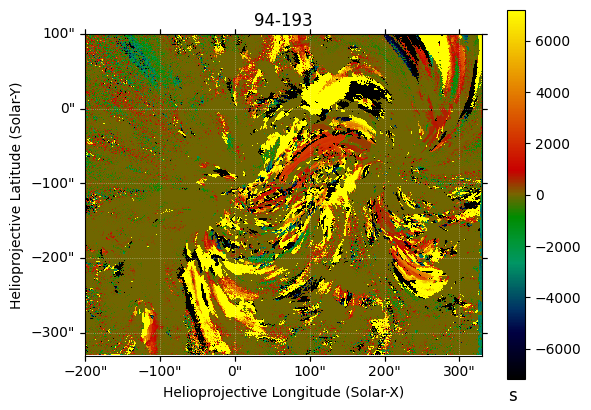

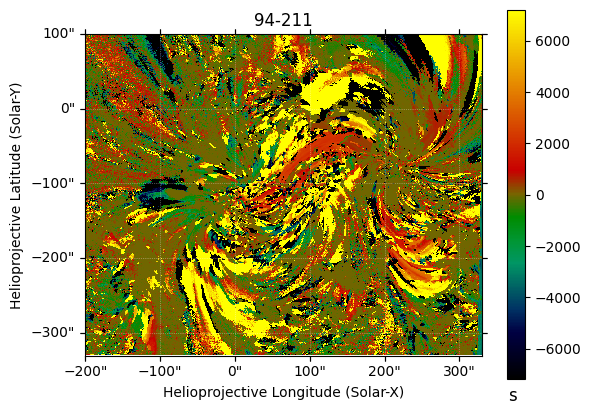

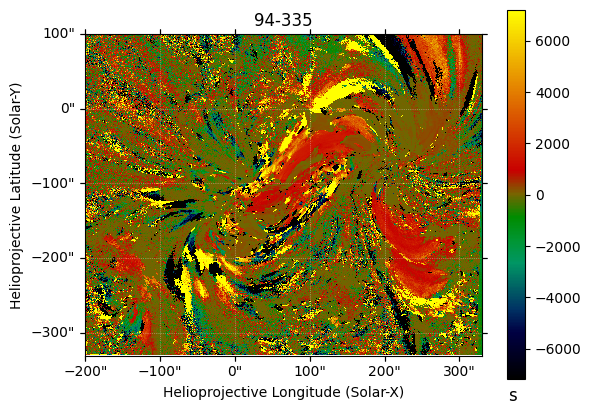

In [11]:
for _map in sunpy.map.Map('../data/noaa_11944/diagnostics/time_lag/timelag_noaa11944_fovAIA_*.fits'):
    _map.peek(cmap='idl_bgry_004', vmin=-7200, vmax=7200,
              title=f'{_map.meta["CHAN_A"]}-{_map.meta["CHAN_B"]}')

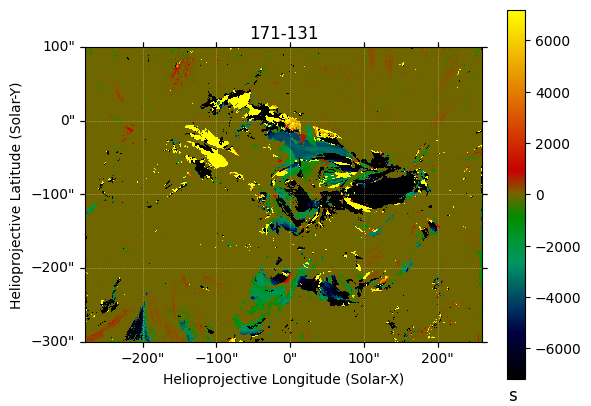

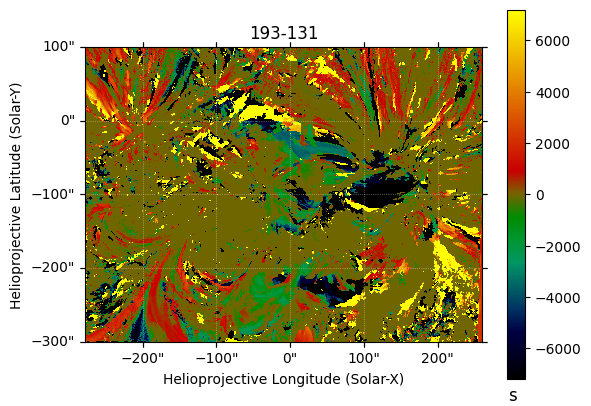

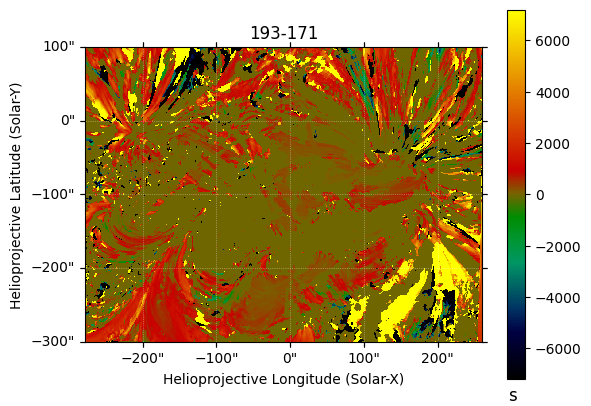

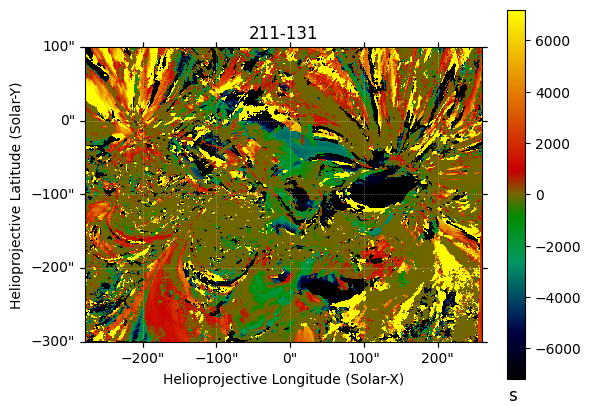

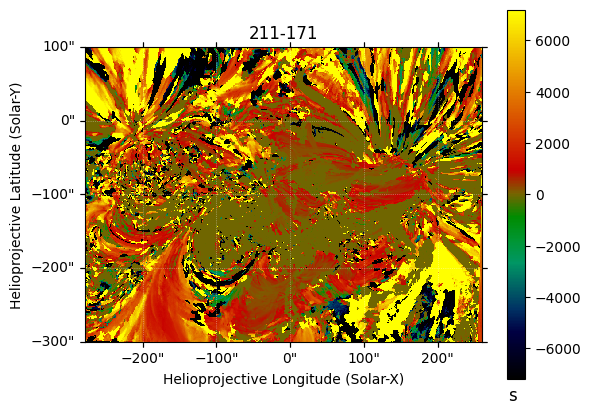

...

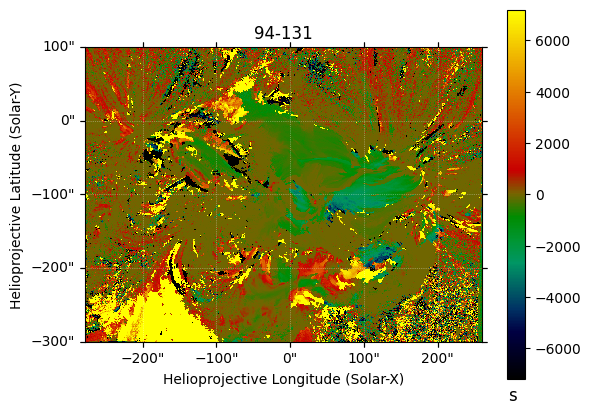

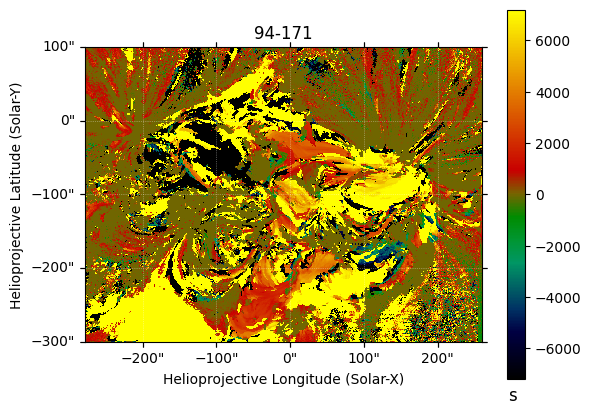

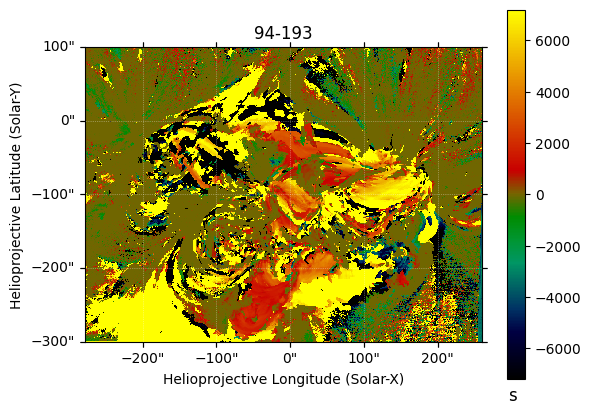

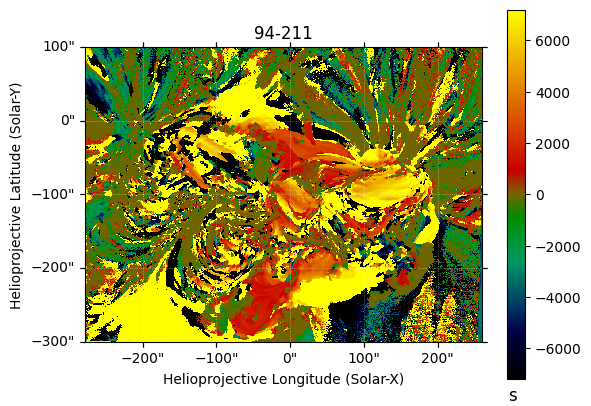

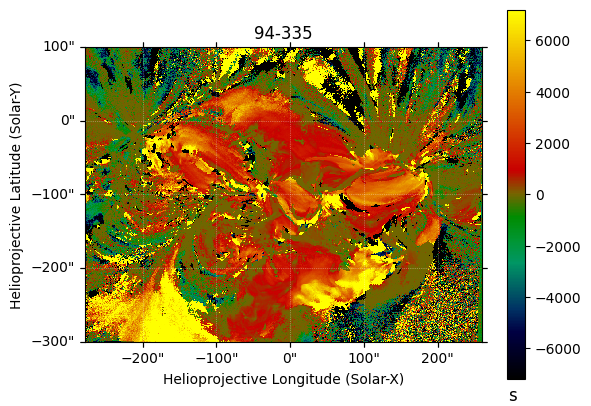

In [12]:
for _map in sunpy.map.Map('../data/noaa_11967/diagnostics/time_lag/timelag_noaa11967_fovAIA_*.fits'):
    _map.peek(cmap='idl_bgry_004', vmin=-7200, vmax=7200,
              title=f'{_map.meta["CHAN_A"]}-{_map.meta["CHAN_B"]}')

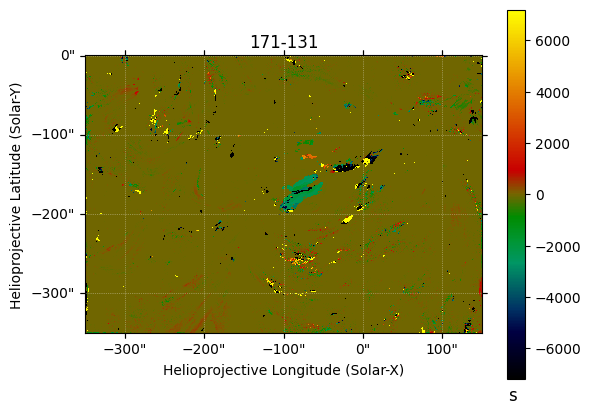

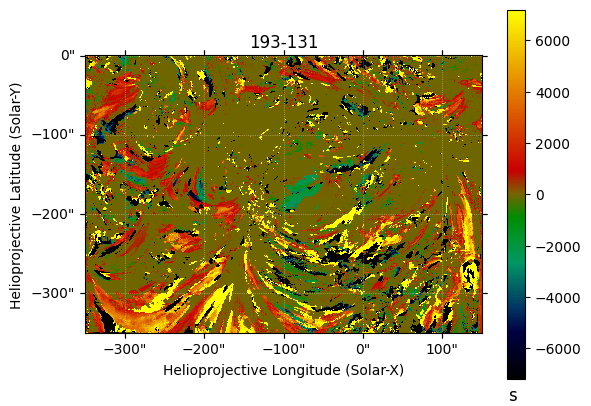

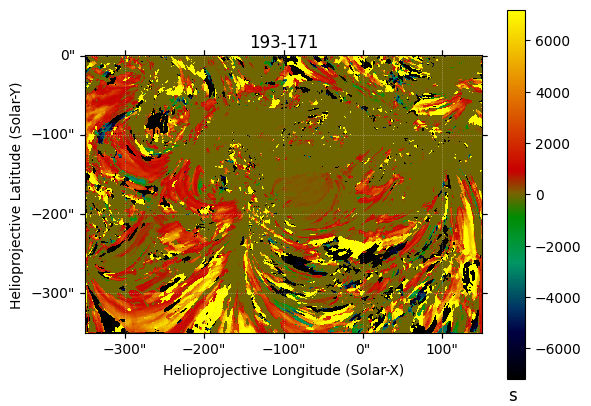

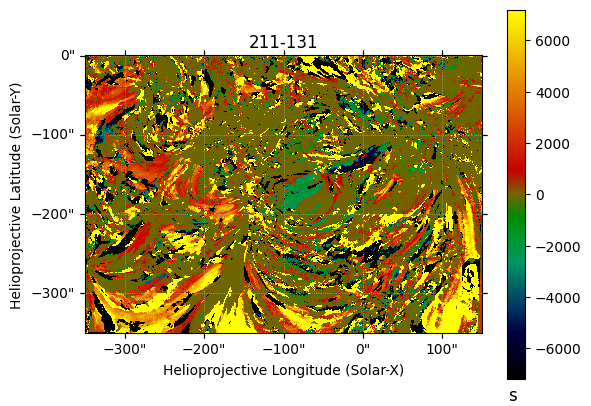

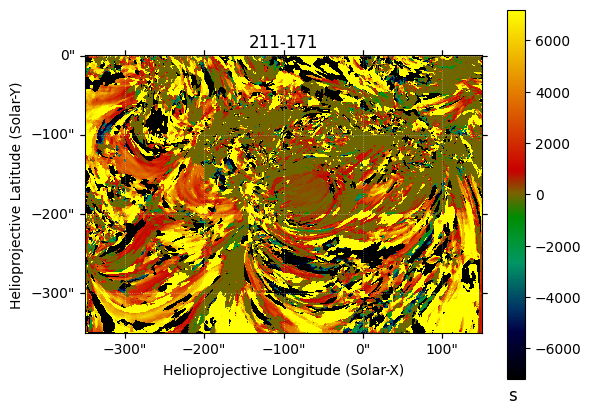

...

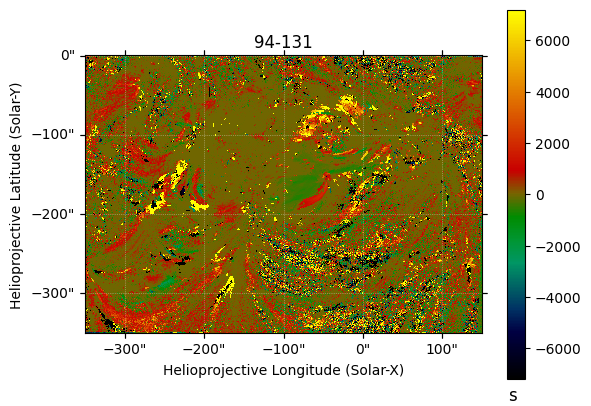

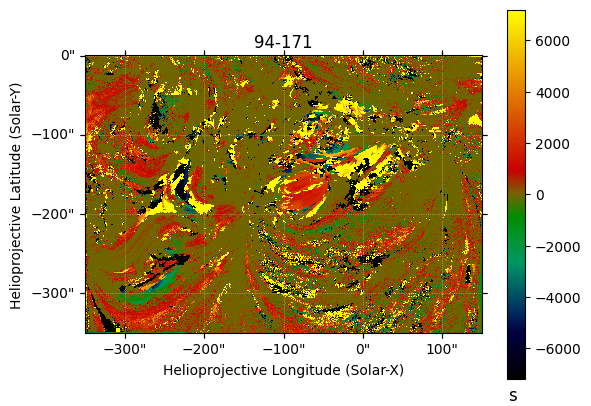

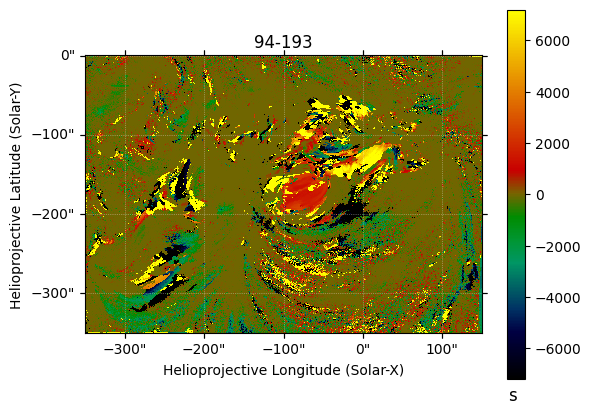

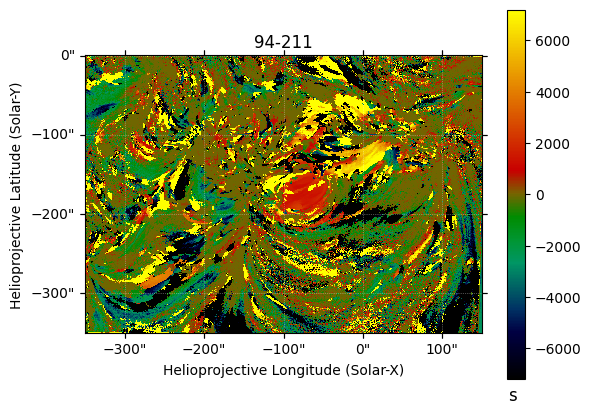

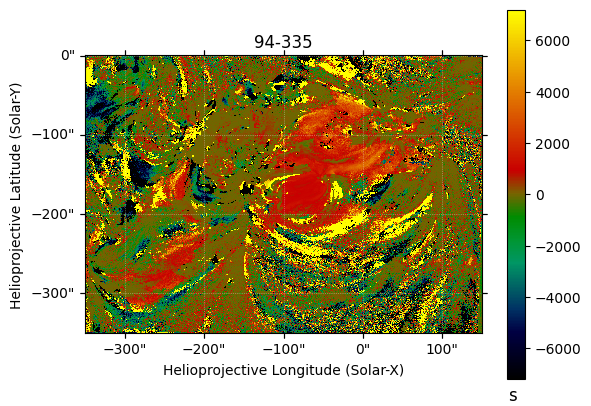

In [13]:
for _map in sunpy.map.Map('../data/noaa_11990/diagnostics/time_lag/timelag_noaa11990_fovAIA_*.fits'):
    _map.peek(cmap='idl_bgry_004', vmin=-7200, vmax=7200,
              title=f'{_map.meta["CHAN_A"]}-{_map.meta["CHAN_B"]}')

## Scratch

In [20]:
ds_11967 = xarray.open_dataset('../data/noaa_11944/AIA/level_2_datacubes.zarr/',
                               engine='zarr',
                               chunks={})

In [21]:
da = ds_11967['131'].compute()

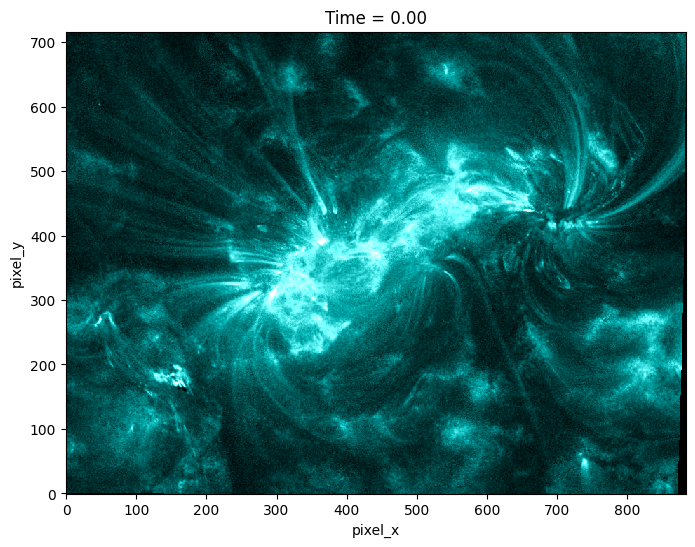

In [22]:
# Get a handle on the figure and the axes
fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot()

_,vmax = AsymmetricPercentileInterval(1,99.9).get_limits(da.data)
norm = ImageNormalize(vmin=0, vmax=vmax, stretch=AsinhStretch())

# Plot the initial frame. 
cax = da[0,:,:].plot.imshow(
    add_colorbar=False,
    cmap='sdoaia131',
    norm=norm,
)

# Next we need to create a function that updates the values for the colormesh, as well as the title.
def animate(frame):
    cax.set_array(da[frame,:,:].values)
    ax.set_title(f"Time = {da.coords['time'].values[frame]:.2f}")

# Finally, we use the animation module to create the animation.
ani = matplotlib.animation.FuncAnimation(
    fig,             # figure
    animate,         # name of the function above
    frames=len(da),       # Could also be iterable or list
    interval=100     # ms between frames
)

In [23]:
ani.save('noaa_11944_131.gif')

MovieWriter ffmpeg unavailable; using Pillow instead.
2024-06-20 19:03:12,913 - tornado.application - ERROR - Exception in callback <bound method SystemMonitor.update of <SystemMonitor: cpu: 3 memory: 3171 MB fds: 37>>
Traceback (most recent call last):
  File "/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/tornado/ioloop.py", line 937, in _run
    val = self.callback()
          ^^^^^^^^^^^^^^^
  File "/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/distributed/system_monitor.py", line 168, in update
    net_ioc = psutil.net_io_counters()
              ^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/psutil/__init__.py", line 2166, in net_io_counters
    rawdict = _psplatform.net_io_counters()
              ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
OSError: [Errno 12] Cannot allocate memory
2024-06-20 19:25:14,416 - tornado.application - ERROR - Exception in callback <bound meth

In [104]:
from IPython.display import HTML

In [105]:
HTML(ani.to_jshtml())

Animation size has reached 21314004 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
